## Camera Calibration

##### by Anastasiia Khaburska

Code and explanations from: https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html

In [1]:
import os
import cv2
import matplotlib
import numpy as np
from matplotlib import pyplot as plt
#from google.colab.patches import cv2_imshow

%matplotlib inline

#### Read and resize data

In [2]:
path_original="./office/" 
path_resized="./resized/"
resize_divide=4

images_original = [cv2.imread(f"{path_original}{image}", cv2.IMREAD_COLOR) for image in os.listdir(f'{path_original}')]

height, width, _ = images_original[0].shape
height = height // resize_divide
width = width // resize_divide

images = [cv2.resize(image, (width, height)) for image in images_original]

for i, image in enumerate(images):
        cv2.imwrite(f"{path_resized}img{i}.png", image)
        
images = [cv2.imread(f"{path_resized}{image}", cv2.IMREAD_COLOR) for image in os.listdir(f'{path_resized}')]      

#### Setup


In [3]:
# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,8,0)
objp = np.zeros((7 * 9, 3), np.float32)
objp[:,:2] = np.mgrid[0:7,0:9].T.reshape(-1,2)

print(objp[:6])
print(".......")
print(objp[56:])

[[0. 0. 0.]
 [1. 0. 0.]
 [2. 0. 0.]
 [3. 0. 0.]
 [4. 0. 0.]
 [5. 0. 0.]]
.......
[[0. 8. 0.]
 [1. 8. 0.]
 [2. 8. 0.]
 [3. 8. 0.]
 [4. 8. 0.]
 [5. 8. 0.]
 [6. 8. 0.]]


In [4]:
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.


***cv2.findChessboardCorners()*** : finds pattern in chess board. In my case 7x9 grid. It returns the corner points and retval which will be True if pattern is obtained. These corners will be placed in an order (from left-to-right, top-to-bottom);

***cv2.cornerSubPix()*** : increase corner's accuracy;

***cv2.drawChessboardCorners()*** : draws the pattern;

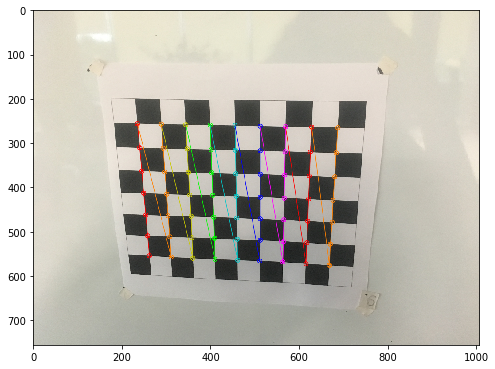

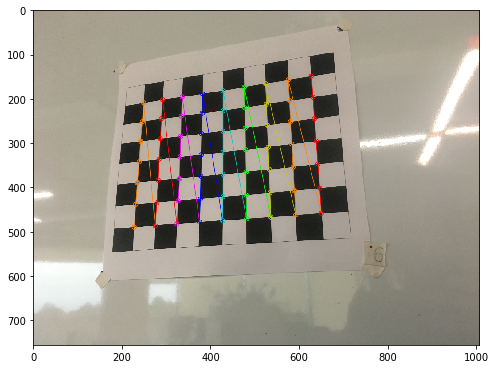

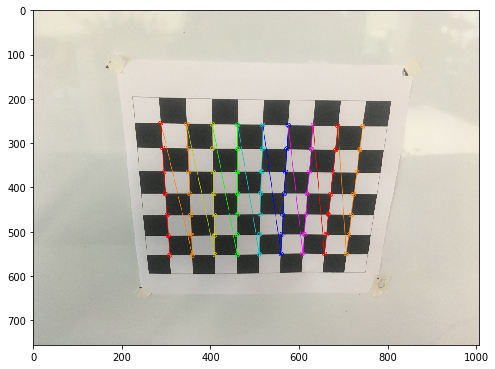

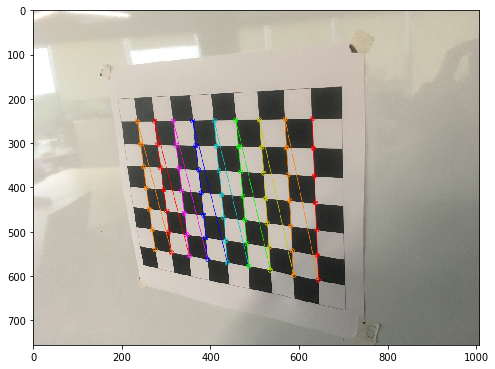

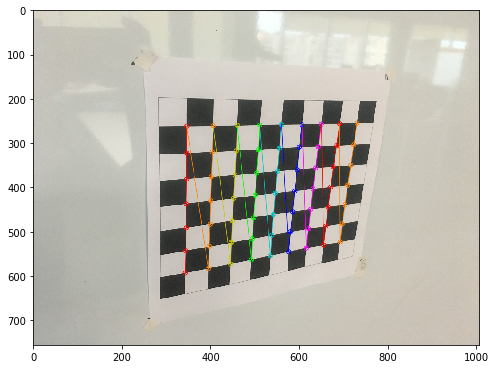

...

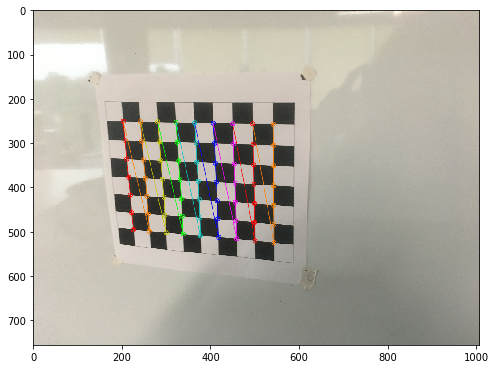

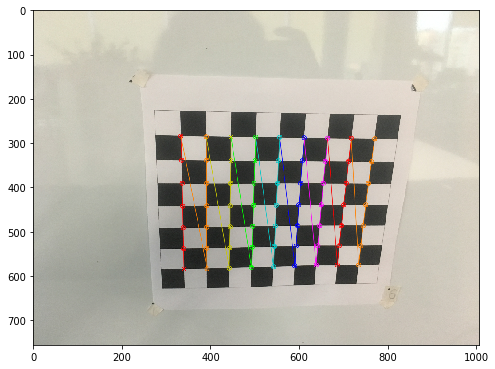

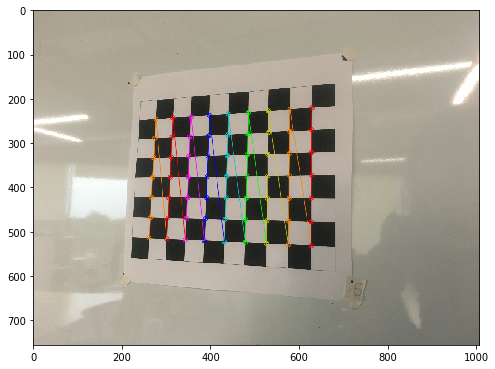

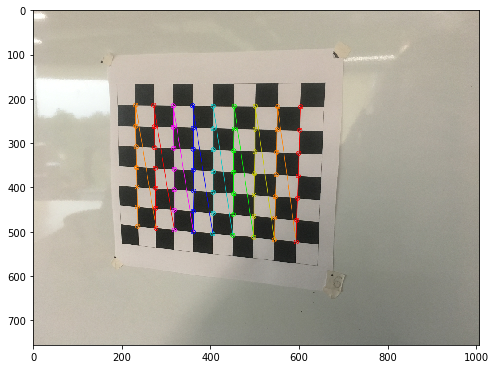

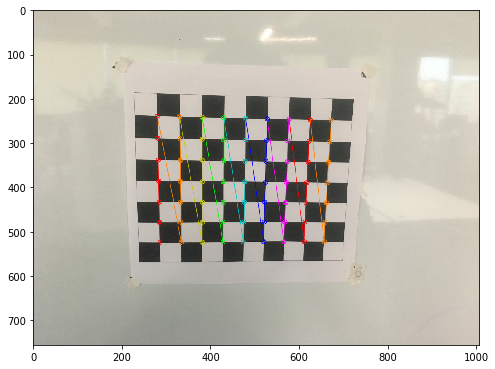

In [5]:
for img in images:
    
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv2.findChessboardCorners(gray, (7,9),None)

    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (7,9), corners2,ret)
        plt.figure(figsize=(8,16))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.show()
   

#### Calibration

***cv2.calibrateCamera()*** : returns the camera matrix, distortion coefficients, rotation and translation vectors etc.

In [6]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
print("ret : "+str(ret))
print("mtx : "+str(mtx))
print("dist : "+str(dist))
print("rvecs : "+str(rvecs))
print("tvecs : "+str(tvecs))

ret : 0.48162935651571376
mtx : [[875.60429217   0.         507.73506874]
 [  0.         873.09982091 379.41723341]
 [  0.           0.           1.        ]]
dist : [[ 0.13646777 -0.43547317  0.00293569  0.00361166  0.49329303]]
rvecs : [array([[ 0.16725619],
       [ 0.31796462],
       [-1.53938779]]), array([[-0.04447836],
       [ 0.4214119 ],
       [ 1.48871327]]), array([[ 0.34667874],
       [ 0.2482807 ],
       [-1.53409133]]), array([[0.58897805],
       [0.17744005],
       [1.52033984]]), array([[ 0.63110318],
       [-0.14637544],
       [-1.52902218]]), array([[ 0.08419905],
       [ 0.01166781],
       [-1.56402996]]), array([[ 0.33586962],
       [-0.04742262],
       [-1.58958523]]), array([[ 0.05556957],
       [ 0.02948171],
       [-1.57101939]]), array([[ 0.3622207 ],
       [-0.31959964],
       [-1.58834994]]), array([[ 0.25368566],
       [-0.33969248],
       [-1.59639914]]), array([[ 0.08069253],
       [ 0.02693623],
       [-1.56640008]]), array([[0.407739

#### Undistortion

***v2.getOptimalNewCameraMatrix()*** : refines the camera matrix. If the scaling parameter alpha=0, it returns undistorted image with minimum unwanted pixels. So it may even remove some pixels at image corners. If alpha=1, all pixels are retained with some extra black images. It also returns an image ROI which can be used to crop the result.

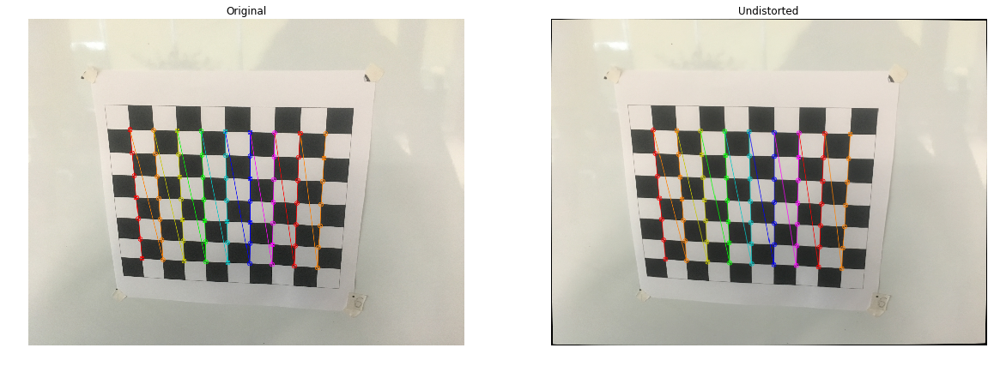

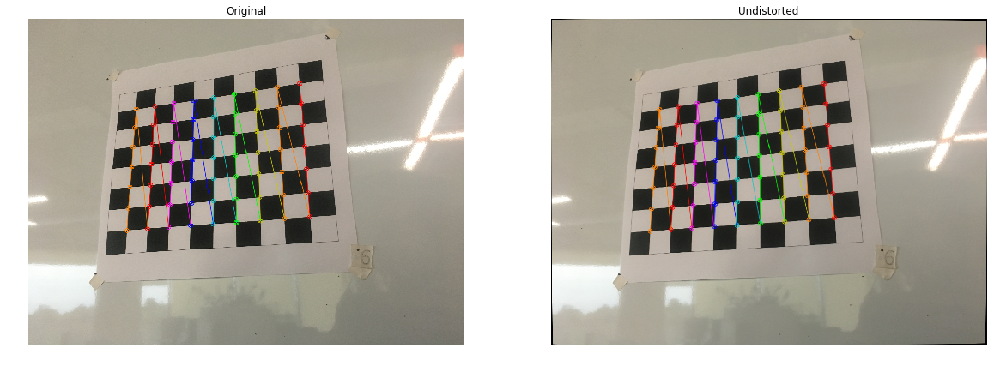

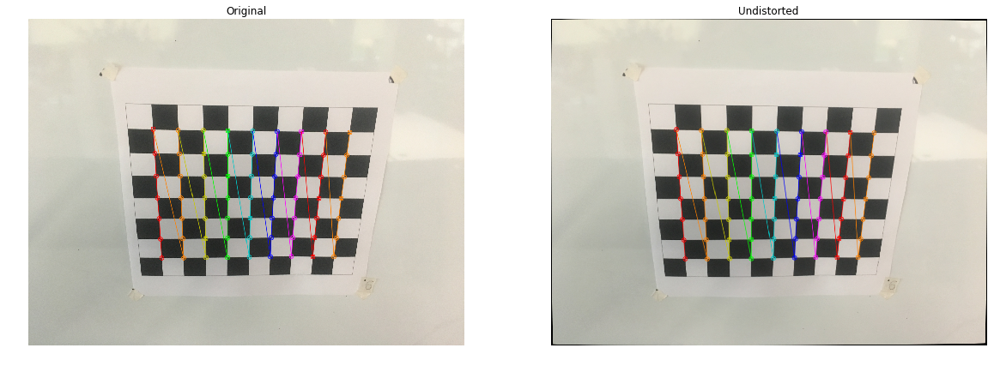

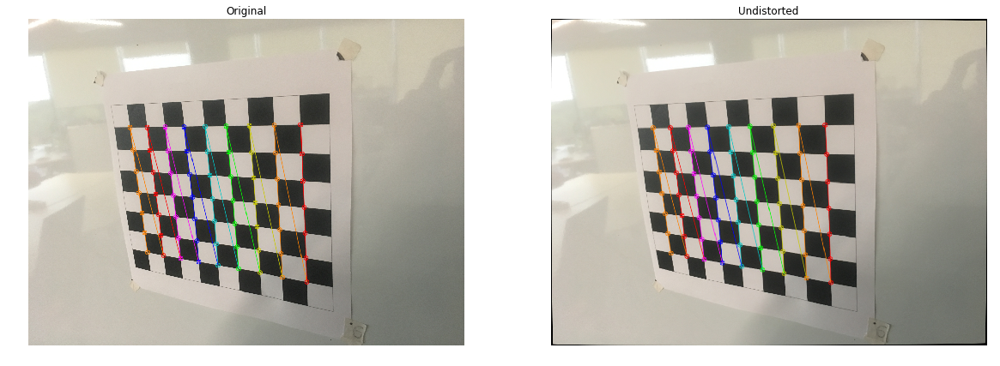

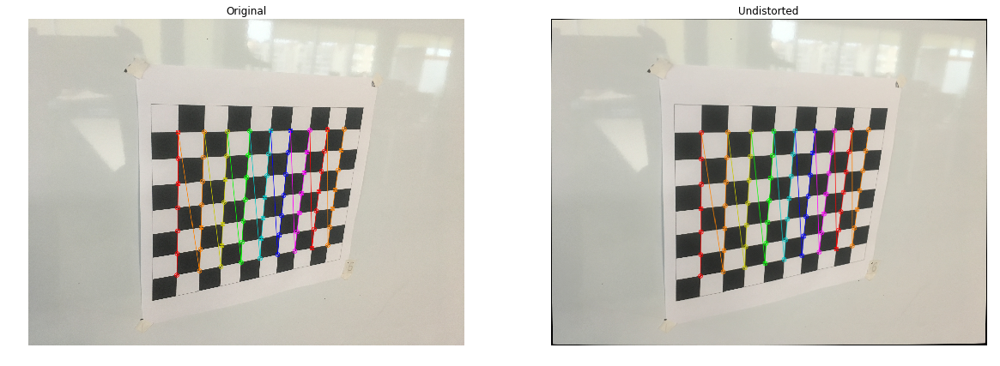

...

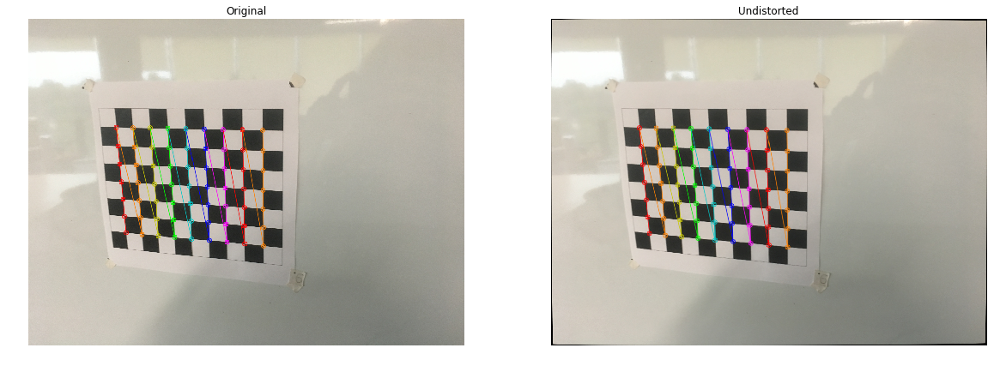

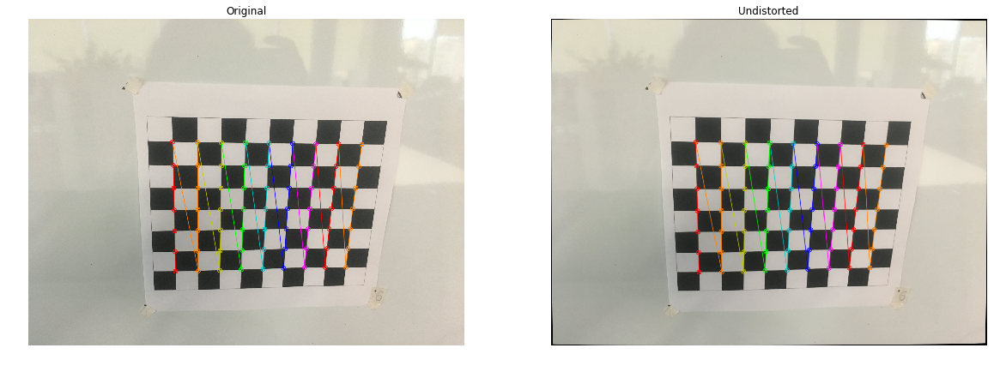

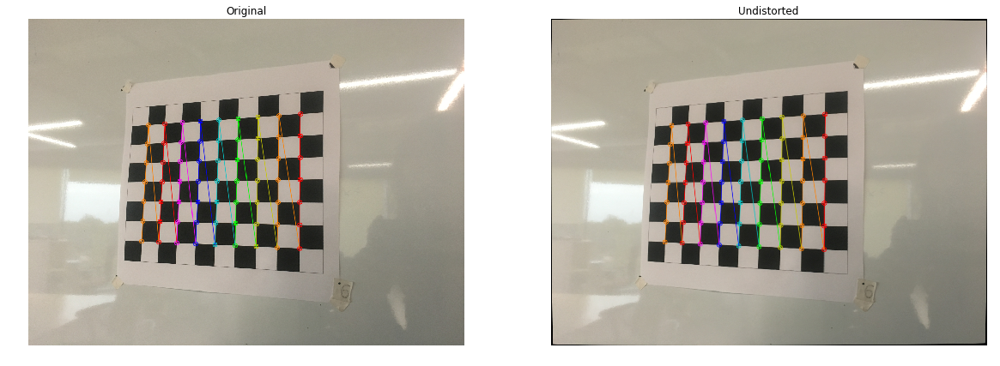

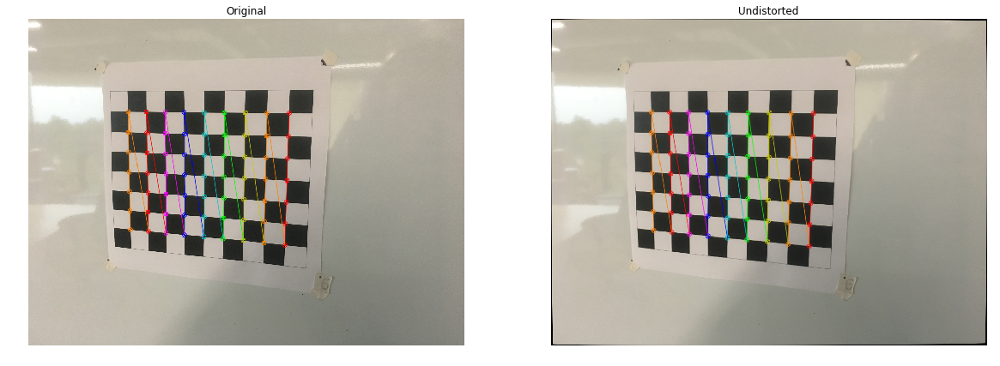

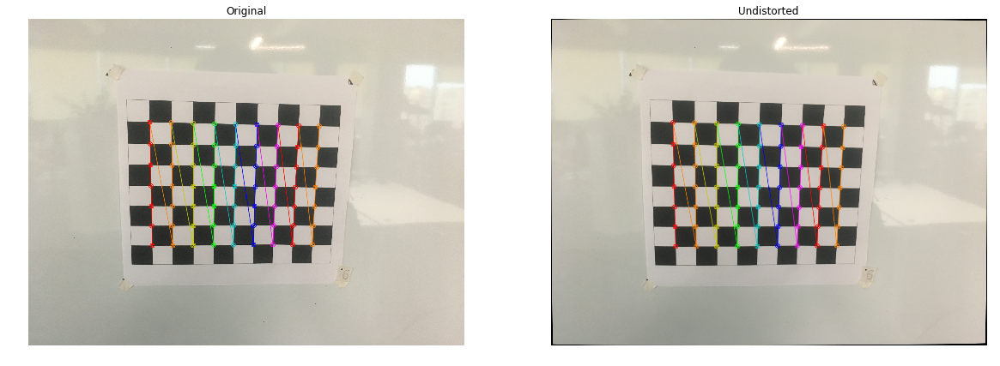

In [7]:
for image in images:
       
    first = image.copy()
    h,  w, _ = image.shape
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
        
    undistorted = cv2.undistort(image, mtx, dist, None, newcameramtx)   
    plt.figure(figsize=(20, 40))
    plt.subplot(121)
    plt.title('Original')
    plt.imshow(cv2.cvtColor(first, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.subplot(122)
    plt.title('Undistorted')
    plt.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
        

In [8]:
path_test_original="./test_original/" 
path_test_resized="./test_resized/"
resize_divide=4

test_original = [cv2.imread(f"{path_test_original}{image}", cv2.IMREAD_COLOR) for image in os.listdir(f'{path_test_original}')]

height, width, _ = test_original[0].shape
height = height // resize_divide
width = width // resize_divide

tests = [cv2.resize(image, (width, height)) for image in test_original]

for i, image in enumerate(tests):
        cv2.imwrite(f"{path_test_resized}test{i}.png", image)
        
images_test = [cv2.imread(f"{path_test_resized}{image}", cv2.IMREAD_COLOR) for image in os.listdir(f'{path_test_resized}')]      

#### Test on images unseen  before

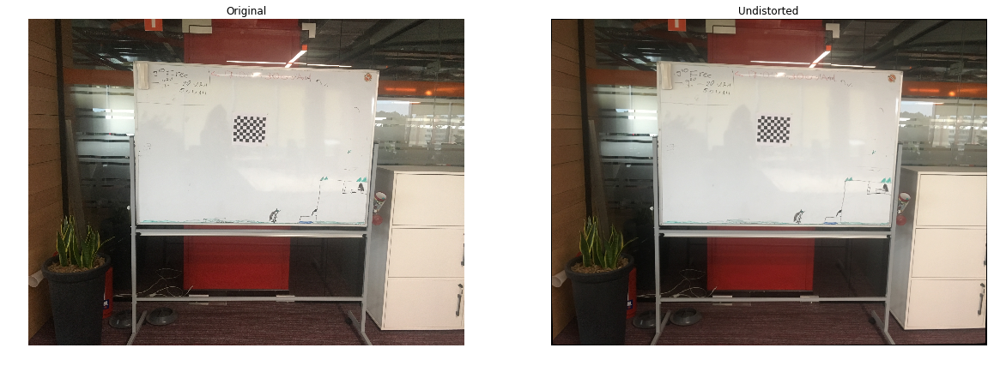

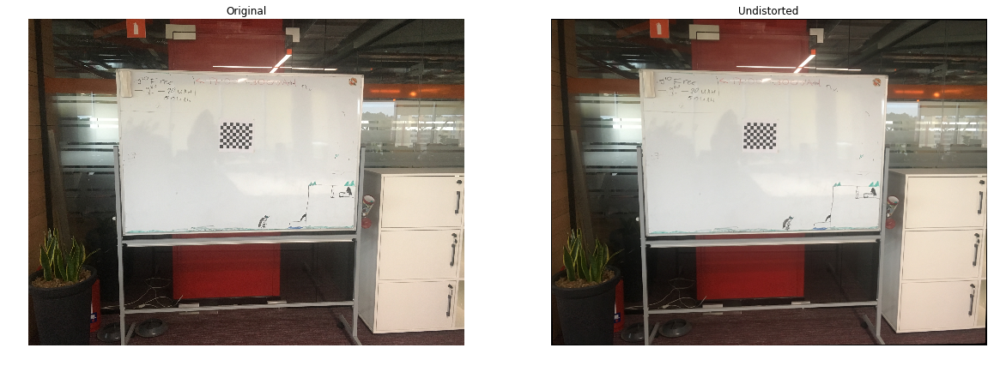

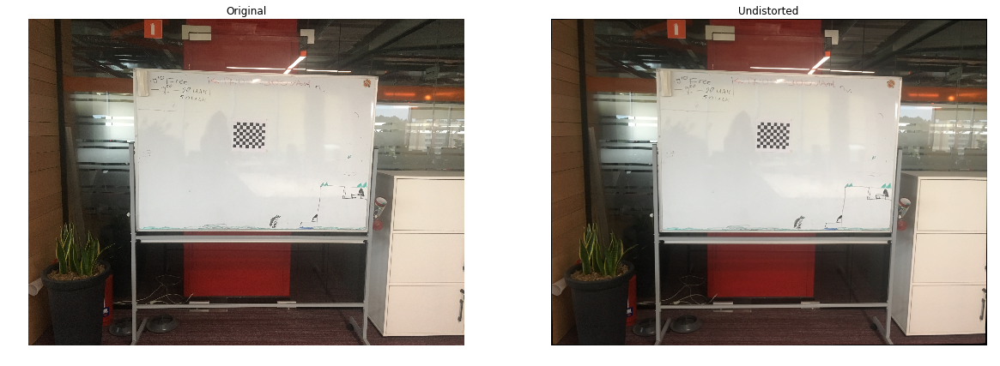

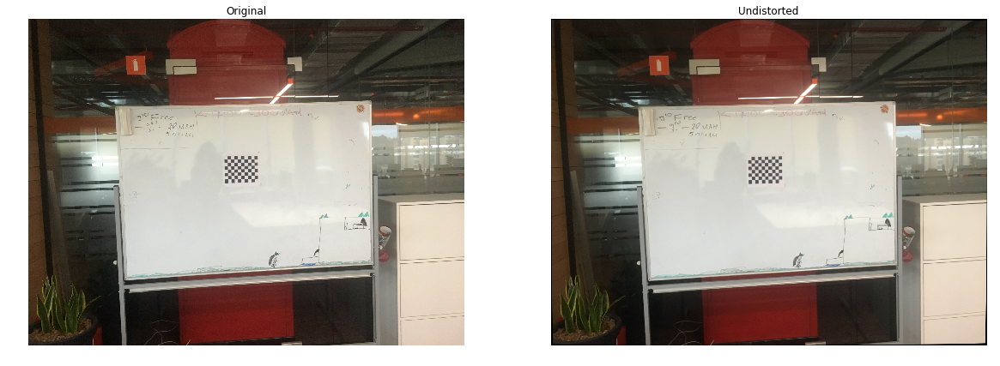

In [9]:
for image in images_test :
       
    first = image.copy()
    h,  w, _ = image.shape
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
        
    undistorted = cv2.undistort(image, mtx, dist, None, newcameramtx)    
    plt.figure(figsize=(20, 40))
    plt.subplot(121)
    plt.title('Original')
    plt.imshow(cv2.cvtColor(first, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.subplot(122)
    plt.title('Undistorted')
    plt.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
        

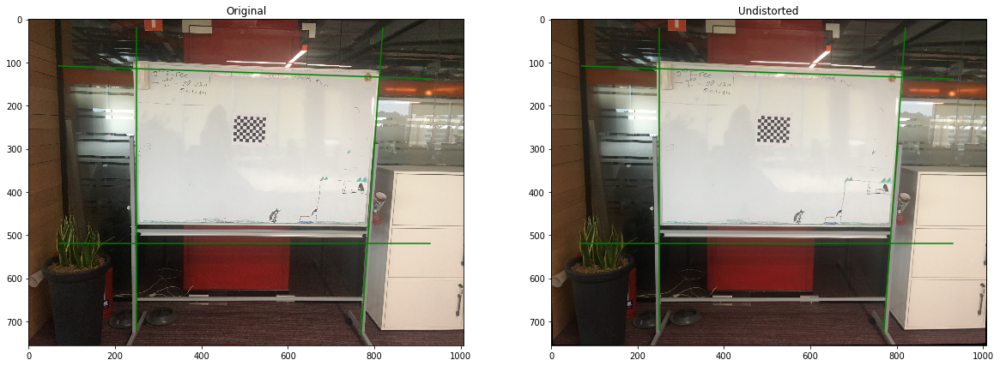

In [10]:
    image=images_test[0]
    first = image.copy()
    h,  w, _ = image.shape
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
        
    undistorted = cv2.undistort(image, mtx, dist, None, newcameramtx)   
    plt.figure(figsize=(20, 40))
    plt.subplot(121)
    plt.title('Original')
    plt.imshow(cv2.cvtColor(first, cv2.COLOR_BGR2RGB))
    plt.plot([70, 930], [108, 138], 'k-', color='green')
    plt.plot([70, 930], [520, 520], 'k-', color='green')
    plt.plot([250, 250], [20, 720], 'k-', color='green')
    plt.plot([820, 770], [20, 730], 'k-', color='green')
    #plt.axis('off')
    plt.subplot(122)
    plt.title('Undistorted')
    plt.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    plt.plot([70, 930], [108, 138], 'k-', color='green')
    plt.plot([70, 930], [520, 520], 'k-', color='green')
    plt.plot([250, 250], [20, 720], 'k-', color='green')
    plt.plot([820, 770], [20, 730], 'k-', color='green')
    #plt.axis('off')
    plt.show()

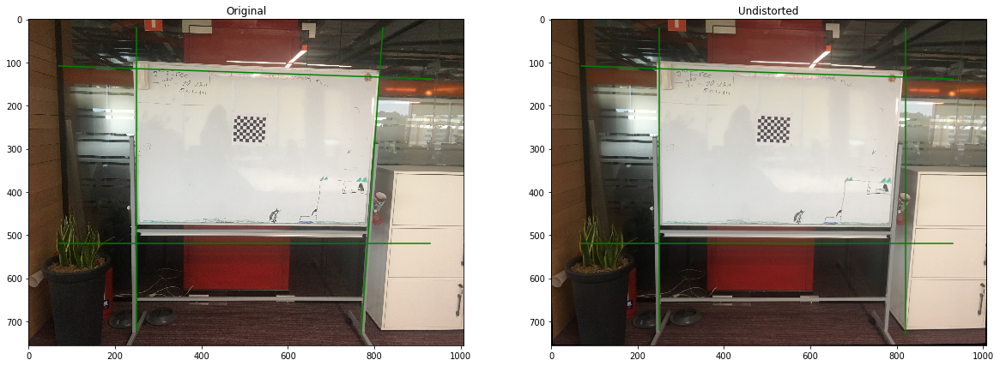

In [11]:
    image=images_test[0]
    first = image.copy()
    h,  w, _ = image.shape
    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
        
    undistorted = cv2.undistort(image, mtx, dist, None, newcameramtx)

    #         x, y, w, h = roi
    #         undistorted = undistorted[y:y + h, x:x + w]
        
    plt.figure(figsize=(20, 40))
    plt.subplot(121)
    plt.title('Original')
    plt.imshow(cv2.cvtColor(first, cv2.COLOR_BGR2RGB))
    plt.plot([70, 930], [108, 138], 'k-', color='green')
    plt.plot([70, 930], [520, 520], 'k-', color='green')
    plt.plot([250, 250], [20, 720], 'k-', color='green')
    plt.plot([820, 770], [20, 730], 'k-', color='green')
    #plt.axis('off')
    plt.subplot(122)
    plt.title('Undistorted')
    plt.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    plt.plot([70, 930], [108, 138], 'k-', color='green')
    plt.plot([70, 930], [520, 520], 'k-', color='green')
    plt.plot([250, 250], [20, 720], 'k-', color='green')
    plt.plot([820, 820], [20, 730], 'k-', color='green')
    #plt.axis('off')
    plt.show()

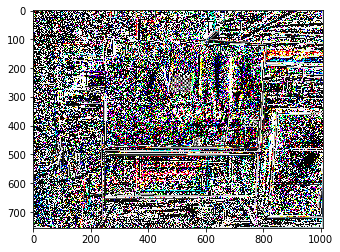

In [12]:
plt.imshow(cv2.cvtColor(undistorted-first, cv2.COLOR_BGR2RGB))

#### Re-projection Error

Re-projection error gives a good estimation of just how exact is the found parameters. This should be as close to zero as possible. Given the intrinsic, distortion, rotation and translation matrices, we first transform the object point to image point using cv2.projectPoints(). Then we calculate the absolute norm between what we got with our transformation and the corner finding algorithm. To find the average error we calculate the arithmetical mean of the errors calculate for all the calibration images.

In [13]:
mean_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv2.norm(imgpoints[i],imgpoints2, cv2.NORM_L2)/len(imgpoints2)
    mean_error += error

print ("Re-projection error: "+str( mean_error/len(objpoints)))

Re-projection error: 0.05852943533022806
